# Homework 2

## Author: Tyler Lang

# 1. CONCEPT QUESTIONS [15 points]

## Part 1

_Please prove the first principle component direction v corresponds to the largest eigenvector of the sample covariance matrix_

$ v=$ arg  $max_{w:||w||\leq 1}  \frac{1}{m} \Sigma_{i=1}^m (w^T x^i - w^T \mu)^2$

For PCA, the goal is to reduce the dimensionality of the data at hand by finding the first-k principle components, which represent, in descending order from the 1st component to the k'th component, the component with the most variability, or the potential to have the most explanatory power, to the lowest. As the principle components are linear, this technique works best for data that takes on a linear form. Thus, the components can be thought of as axes along which the data can be represented in a lower dimensional form along the axes, with each princinple component running orthogonal to the previous one, as a way to maximize the variability captured in the components. 

To choose a direction to maximize variance, we want to maximize the distances of the points **projected on the line** from the centroid, and maximize the range of the projected points. Thus, we can measure this for any given principle component by doing exactly that - projecting the points onto the line, and measuring the distance from the "centroid" of the line, or the middle point of all the projections on the line. 

In the equation above, $w^T x^i$ refers to this projected data, and $w^t \mu$ refers to the mean point, or the centroid of the component / line of projected data. Thus, in the top equation, we are simply maximizing the average sum of squares of the distances of each point from the center point. 

With some linear algebra, we can trandform this equation, by first factoring out the $w^T$, then taking it outside of the squared term, and changing the order of multiplication by changing the transpose: 

Thus, so far, we have 

$\frac{1}{m} \Sigma_{i=1}^{m} w^T (x^i - \mu)(x^i - \mu)^T w$, 

which, as can easily be seen, be re-written, by means of taking the w-terms out of the sum (as they do not depend on the i through m values), leaving the Covariance matrix as the average of the sum of the differences between the x-points and the mean value. Thus, we can write it as $W^T C W$, where C is the covariance matrix. 

Now that we have this specific optimization problem, now re-written to include the covariance matrix, which has a constraint of $||w||\leq 1$, we can then re-write the problem again to form a Lagrangian function, which is a technique used in optimization to combine objective functions and their constraints into one objective function with punishment terms based on the constraints, as a way to make a problem computationally easier, and _possibly_ relax the constraints, depending on if the problem is convex or not. That being said, we can now again re-write the optimization problem as 

$L(w,\lambda) = w^T C w + \lambda(1-||w||^2)$

Now, as with many applications of the Lagrange, the lambda simply serves as a way to make the contsraint a weak constraint, but we are still maximizing w. Thus, if there is a point at which the function is stationary, then there should be an optimal w and $\lambda$ which forms a stationary point, at which we get the maximum objective value.

Thus, if this is true, then we can look at the implications with the first derivative, which implies that the derivative of L(w,$\lambda$) (above), would become 2Cw - 2$\lambda$ w = 0, and then rearranging, we get Cw = $\lambda$w, or in other words, because C is a matrix and w is a vector, $\lambda$ thus serves as an eigenvalue, and w an eigenvector of C. And because we are maximizing the objective function, we'd end up with a value for v that corresponds to the largest eigenvector. The second principle component would correspond to the second largest eigenvector, and so on. As the largest eigenvectors capture the highest variabiity in the original matrix.

=======================================================

## Part 2

_What is the relationship between SVD and eigendecomposition? Please explain this mathematically, and touch on why this is relevant for PCA._

Eigendecomposition and SVD are both methods use to decompose a matrix into different components, and can both be used in determining principle components. 

SVD serves as a way to represent a matrix as a stretching and a rotation of an (x,y,...) vector, or point in an n-dimensional space. In other words, we can use SVD to represent a matrix as a transformation of one orthogonal grid into another one via shears and rotations. The output of SVD on a matrix are three variables: $U\Sigma V^T$. $U$ represents the new orthogonal grid's basis, while V represents the original orthogonal domain (and both are normal, thus being orthonormal), and thus can represent rotations... while $\Sigma$, in simple terms, represents the transformations, or stretches, done on the vectors in V to arrive at those in U. Furthermore, in SVD, the matrices U and V are distinct matrices which are not diagonal, and the multiplication of $U\Sigma V^T$ ensures preservation of the original shape of the matrix (in other words, U and V are not exclusively square matrices), meaning that SVD can be performed on any matrix of any shape. 

With Eigendecomposition, however, the process of finding the eigenvalues and vectors is a slightly different way of representing a decomposition of a matrix. With eigendecomposition, we are looking for a set of scalars and vectors in which, if the vectors (represented as x) were transformed by the matrix, it would lead to the _same solution_ as if the vectors were simply multiplied by a set of scalars. In other words, we are looking for vectors that are NOT ROTATED by the matrix, but rather the "lines" or vectors on which the matrix simply stretches the vector along its same plane, otherwise making the transformation equivalent to a scalar multiplication. As can be seen, this process is inherently different from SVD, and many times will represent a different form of decomposition (leading to different results), UNLESS the matrix is _square symmetric positive semidefinite_, in which the results will be the same (such as the covariance matrix), in that the columns of $V$ will be the eigenvectors, and the values of $\Sigma$ will be the square roots of the eigenvalues. The other major difference is that, with eigendecomposition, the eigenvectors and values can be real numbers, complex numbers, positive, or negative, while in SVD, the values in $\Sigma$ are always non-negative and real. The SVD can be taken of any matrix, and always exists, where the eigendecomposition of a matrix might not exist, and certainly does not exist for any non-square matrix.

Thus, when using either of these for decomposition and in the process of PCA, SVD will work every time, no matter the size or type of matrix. Because of eigendecomposition's restrictions, we must take the eigenvalues of the covariance matrix, not the original matrix itself, while we can decompose the original matrix directly with SVD (yet the same results will come from using SVD on the covariance matrix as well). Depending on the amount of principle components needed, too, the eigendecomposition formula in python has more instability in accuracy for the smaller eigenvalues, than the bigger ones, whereas SVD does not suffer from this same problem, thus making SVD potentially more precise.

=========================================================================

## Part 3

_Explain the three key ideas in ISOMAP (for manifold learning and non-linear dimensionality reduction)_ 

When data does not have linear properties, dimenstionality reduction using linear methods such as traditional PCA via eigendecomposition or SVD prove to be quite pointless, depending on the level of non-linearity present in the data. Thus, ISOMAP proves to be one clever way to reduce dimensionality in data while preserving its natural shape, or more specifically, preserving its "walking distance over the data cloud," as directly described in lecture. 

The basic process of ISOMAP is that, 

(1) First, neighbor points are found for each data point, either within a specific Euclidean distance, $\epsilon$, or by using the k-nearest neighbors approach. Then, an adjacency matrix is created to show these WEIGHTED relationships of the data points. 

(2) Then, the shortest __walking distance__ is found between each pair of points, based on A, by traveling from one point to another via "walking" from neighbor point to neighbor point in the data cloud, and finding the combination of "walks" that lead to the shortest distance. 

(3) Finally, this matrix of shortest paths between all pairs of points (matrix D), can be represented in a low-dimensional way, which preserves these distances. For example, for 3-dimensional data, all the walking paths can be simply represented in a 2D space, by separating the points out by their euclidean equivalent distance as that seen in D, thus creating a 2D plot of the 3D data. 

===============================================================

# 2. Eigenfaces [42 points; 2 bonus]

In [1]:
import numpy as np
import pandas as pd
from PIL import Image as I
from os import listdir
from os.path import isfile, join
from sklearn import decomposition
import matplotlib.pyplot as plt
import scipy.sparse.linalg as lin
from matplotlib.offsetbox import AnnotationBbox, OffsetImage
from scipy import ndimage
import scipy.io as spio
import sklearn.utils.graph_shortest_path as gs
import networkx as nx

In [2]:
plt.rcParams['figure.figsize'] = [5, 5]

In [3]:
def photo_loader(subject_string,data_folder,not_in_string):
    picfiles = [f for f in listdir(data_folder) if isfile(join(data_folder,f))]
    pics_raw = []
    data = []
    pics = []
    for base_path in picfiles:
        if not_in_string not in base_path:
            if subject_string in base_path:
                temp = I.open(data_folder+base_path)
                temp = temp.resize((temp.size[0]//4,temp.size[1]//4))
                temp_array = np.array(temp)
                data.append(temp_array)
                pics.append(temp)
    data_vector = []
    for mat in data:
        data_vector.append(mat.reshape((1,mat.shape[0]*mat.shape[1])))
        matrix = np.concatenate(data_vector, axis=0 )
    return pics,data,matrix

In [4]:
def PCA_TJL(matrix,total_vecs):
    m,n = matrix.shape
    st_dev = np.std(matrix,axis = 0)
    if (st_dev==0).sum() == 0:
        norm = matrix@ np.diag(np.ones(st_dev.shape[0])/st_dev)
    else:
        norm = matrix
    # Many calculations taken from sample code given to us
    norm = norm.T
    mu = np.mean(norm,axis=1)
    xc = norm - mu[:,None]

    C = np.dot(xc,xc.T)/m 
    S,W = np.linalg.eig(C)
    S = S.real
    W = W.real
    idx_sorted_biggest = (np.argsort(S))[::-1]
    Z = W[:, idx_sorted_biggest[:total_vecs]].real
    return Z

def print_eigs(Z_matrix,shape):
    for e in range(Z_matrix.shape[1]):
        plt.imshow(Z_matrix[:,e].reshape(shape),cmap='gray')
        plt.show()

For this question, we are taking two subjects, and for each subject, we have nine to ten photos of this subject in slightly different poses, with or without glasses, or with different shadowing. For each subject, we can take these photos and reduce their dimensionality to get "base face" images which have the highest explanatory power for all the given subject face photos, but in one single photo (which can be repeated for all eigenface vectors). For each subsequent eigenface, we expect the "explanatory power" of that eigenface to be less and less for each subsequent eigenface, due to the nature of eigendecomposition packing in the most variability into the first-k eigenvectors, which helps us reduce dimensionality of the data at hand. 

To start with this assignment, the photos must be read in, and then down-sized by a factor of 4. As we were told specifically in the assignment that we could use a package to do so, such down-scaling is simple with the PILLOW package, which has its own "resize" function, which preserves image features while downsizing. To load the photos in, I simply created a function that takes the base folder's path, and then grabs, in a list, the file names for all files in that folder that DO NOT include a specific substring (which I then use to NOT load the test photos yet, and thus only include the training photos in the analysis). Within a for-loop, those file paths are combined with the folder path, and used to read in the photo using PILLOW.IMAGE. The photo is resized, and then turned into an array. Finally, once all the photo arrays are loaded in and packed into a list, I then run another for loop to turn each matrix into a row vector, and then finally combine these row vectors into a final data matrix for a single subject. This process is entirely included in the function, "photo_loader", whose use is noted below. The final output are the actual photos, the raw data arrays in a list, and the final single data matrix which is used further for analysis.

## Part a

_Top 6 eigenfaces per subject_

Below, I load the photos as described above, using one simple function, which loads only the photos for either subject 1 or 2, and excludes the test photos.

In [5]:
data_folder = r'data/yalefaces/'
photos1, raw1, m1 = photo_loader('subject01',data_folder,'test')
photos2, raw2, m2 = photo_loader('subject02',data_folder,'test')

Now that I have my data matrix per subject, I will perform PCA on the matrix to reduce the dimensionality of the photos, and find the first 6 principle components. As the ultimate goal is to find principle components PER SUBJECT, not per photo, the shape of the matrix has to be such that each eigenvector is a full face, taking the eigenvectors across the pixels, not the faces. In other words, we are NOT reducing the amount of pixels, but rather trying to represent ALL the photos as k-eigenfaces. This becomes important in how the data matrix is structured for further calculations and analysis. In this case, we will have a covariance matrix that has the same dimensions as the amount of pixels present per photo, which serves to show the relationships between the different pixels among all the photos in the training set. 

To get the covariance matrix, I first normalize the matrix if possible, as just a way to make the decomposition process more stable and less dependent on drastic pixel-shade variations. If normalization cannot take place due to divide-by-zero errors (due to 0 Standard deviation), then it is not performed, which still leads to perfect results. Then, using the same principles in the sample code, I find the mean value per column (per photo) of each pixel, subtract it from each column of the original matrix, and find the covariance matrix using the equation shown in lecture, and in the code in my function. Finally, I can use eigendecomposition on the covariance matrix (as the covariance matrix is now a square, with row and column dimensions equal to the amount of pixels in a photo), and finally take the k-largest eigenvectors (the eigenvectors associated with the largest eigenvalues). 

There is much debate in the data science field whether PCA should be performed with eigendecompoisition or SVD, and for SVD, whether SVD should be performed on the original data or the covariance matrix. I chose to use eigendecomposition, which should give the same results as using SVD on the covariance matrix, as the covariance matrix is square symmetric positive semidefinite. Although eigendecomposition can sometimes suffer from error in the eigenvalue for the lowest eigenvalues (due to how numpy performs eigendecomposition), this should not be a problem, as we are only extracting the first 6 eigenvectors corresponding to the largest eigenvalues. 

Finally, a matrix of these k-eigenvectors is output, which will then be used to represent the eigenfaces. 

This entire process is encapsulated in my function, PCA_TJL, which simply takes the data matrix and the desired amount of final eigenvectors (the k-value), and outputs the Z matrix of k-eigenvectors.

In [6]:
Z_subj1 = PCA_TJL(m1,6)

In [7]:
Z_subj2 = PCA_TJL(m2,6)

Once I have the final Z-matrices for each subject, I can then use my function, "print_eigs", to print out the final photos, or eigenfaces. In the case of my code, each column in each Z is an eigenvector, which is then resized into the original dimensions of the training photos, and it is mapped to gray-scale. The image is then shown with plt.imshow().  

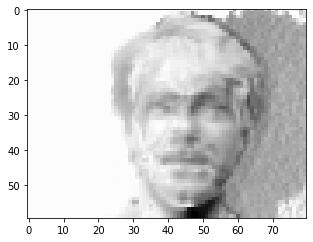

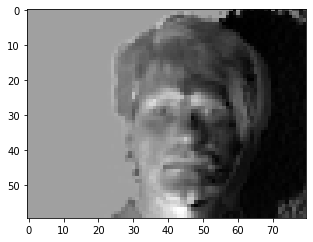

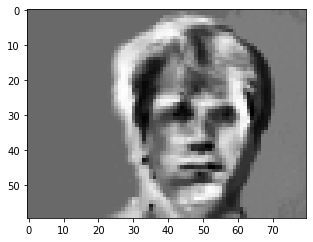

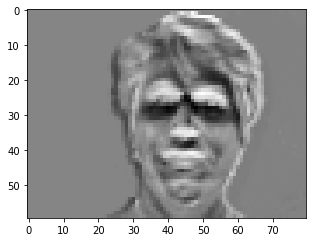

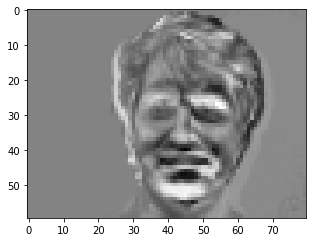

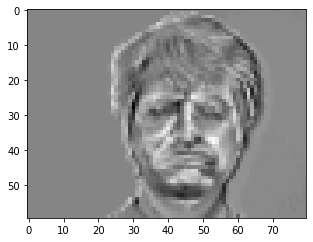

In [8]:
print_eigs(Z_subj1, raw1[0].shape)

The results are exactly as expected, in that, first off, the first eigenface has the most detail, and most strongly represents the original images. As we move to the 6th eigenface, detail is slowly lost, and the eigenfaces go from showing better details in the shadowing of the face, to showing more rough outlines of facial details, capturing more of some of the random expressions shown in the training photos, like in subject 1's 6th eigenface, which represents the training photo in which the subject makes an upset face. Eigenfaces 1 and 2 seem to really capture the strongest and most subtle features in the subject, while eigenfaces 3 and 4 capture more of the harsh shadowing inherent in the photos. Finally, 5 and 6, as mentioned, seem to show more harsh outlining in the photos, sometimes capturing some of the specific expressions shown in some of the original photos.

After seeing the results for subject 1, I will analyze the results for subject 2.

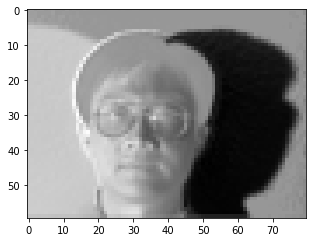

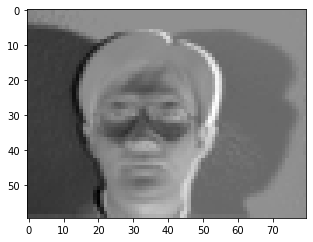

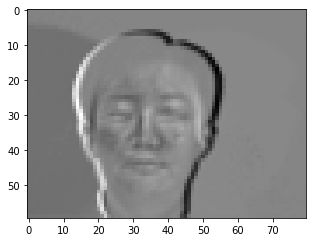

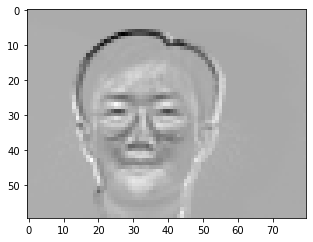

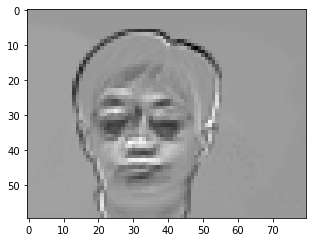

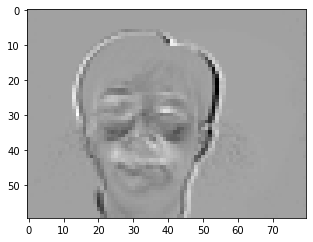

In [9]:
print_eigs(Z_subj2,raw2[0].shape)

Again, the same trends seem to be noted in the eigenfaces of subject 2. 

Eigenfaces 1 and 2 represent the most subtle shadowing and facial features of the subject, also capturing some of the harsh shadowing present in some of the training photos. Eigenface 2 seems to stress the harsher facial shadowing, possibly influenced by the subject's glasses shape. 3 through 6 definitely show a degradation of facial qualities being picked up by the principle components, with eigenface 6 now hardly representing the subject, except for the simple outlining of the hair and upper-face. Eigenface 5 seems to, again, like with subject 1, pick up on a random facial expression more than the others, and also shows the pouty/sad face, which is interesting. Perhaps it is due to the distinction in the pixel shades for these more dramatic facial expressions due to the shadowing and highlighting it causes around the lips and cheeks. Eigenfaces 3 and 4, like before, show more of the harsher outlining of the subject rather than the subtle shadowing, but still represent the subject rather well. 

What I do find interesting, is that while both subjects show strong degradation in terms of qualities from eigenfaces 1 to 6, qualitatively, I feel as though subject 2's eigenface qualities degraded much faster, with eigenface 6 now hardly being recognizable, while for subject 1, eigenface 6 still somewhat represents all the subject's main features, even if extremely degraded with harsh shadowing. 

I believe, subjectively, this might be due to the features of the subjects, in that subject 1 has more harsh facial features causing more extreme shadowing from these stronger facial features, while subject 2 has softer features, and thus the eigenfaces for subject 2 degrade faster within a given amount of eigenfaces.

# Part b

_Facial regonition_ 


For this part of question 2, after performing eigendecomposition and finding the first 6 eigenfaces of the two subjects, we are then asked to take the very first eigenface of each subject, and calculate the projection residual of each respective eigenface with its test image, to see if facial recognition can be successfully performed. In other words, we are testing to see if the projection residual, which is a type of dissimilarity equation, matches the eigenface of subject 1 (by having the smallest value of S), or erroneously matches it with subject 2. While we only have 2 subjects with very different features, there should not be much difficulty in this task, but it would be curious to test this task with the entire database of the photos used in the Yale study. 

Thus, to be able to perform this task, I load the test photos using my same "photo_loader" function, grabbing just the two test photos, and turning them into their own vectors, t1 and t2, which I then concatenate into a matrix to make running a for loop easier. Then, I run a for-loop that, for each combination of eigenfaces 1 and 2, and each test photo 1 and 2, calculates the projection residual per combination, and prints the final result, which I will analyze below.

In [10]:
test_photos, test_raw, test_m = photo_loader('test',data_folder,'XYZ')

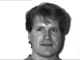

In [11]:
test_photos[0]

In [12]:
t1 = (Z_subj1[:,0]).reshape(((Z_subj1[:,0]).shape[0],1))
t2 = (Z_subj2[:,0]).reshape(((Z_subj2[:,0]).shape[0],1))

In [13]:
trained_eigs = np.concatenate([t1,t2],axis=1)

In [14]:
print('Projection Residual Scores: \n')
proj_res_dict = {}
for i in range(2):
    for j in range(2):
        
        trained_eig = trained_eigs[:,i].reshape((trained_eigs[:,0].shape[0],1))
        test_vect = test_m[j,:].reshape((test_m[0,:].shape[0],1))
        score = np.linalg.norm(test_vect - trained_eig@trained_eig.T@test_vect,2)**2
        print(f'Eigenface for Subject {i}, Test Photo of Subject {j}: {score}')
        proj_res_dict[(i,j)] = score

Projection Residual Scores: 

Eigenface for Subject 0, Test Photo of Subject 0: 44597128.809878804
Eigenface for Subject 0, Test Photo of Subject 1: 97857466.63563174
Eigenface for Subject 1, Test Photo of Subject 0: 195226516.64214858
Eigenface for Subject 1, Test Photo of Subject 1: 175653205.93013072


As can be seen, the smalles value of S correctly identifies each subject's eigenface from the trained data to its test photo. The value of S for subject 0, test photo 0 is 6678, lower than that of s0,t1 of 9892. 

Also, s1, t1 has a value of 13253, which is lower than the value of s1,t0. As the value of S relates to dissimilarity, lower values for each combination per subject would result in a "match" in a facial recognition program. Thus, as expected, the program worked successfully using eigenfaces, at least in this case, in which the subjects are quite distinct and unique.

## Part c [Bonus: 2 points]

_Possible advantages and disadvantages of using eigenfaces for facial recognition tasks_

There are definitely various _advantages_ and _disadvantages_ when it comes to using eigenfaces for the purpose of facial recognition. 

Some of the **advantages**: 

Some of the main algorithms used for facial recognition nowadays involve deep learning, which could potentially require a lot of data and work, and can be potentially expensive algorithms to formulate. Thus, for any simple facial recognition task, deep learning might be too intensive to be worth it, which is where the simplicity of eigenfaces can make for a great, easy, and cheap alternative. Furthermore, using eigenfaces can use even a small subset of data to train on, and requires almost no processing of the images, besides simply turning the photos into an array of pixels. It is a very direct appearance-oriented approach to matching a person with that person's principle eigenface, and requires no knowledge whatsoever about facial shadowing, or looking to match specific features of a face. It simply looks at pixel shading values, which visually capture the facial features. It's also a very fast algorithm, using simple linear algebra to complete the task, once the eigenfaces are extracted and stored.

However, because this is very much an image-matching process that looks at the dissimilarity of pixel shading, it also has some big **disadvantages** that I can imagine would hinder a perfect facial recogniition program. 

Because of the way in which this type of program stresses comparing direct visual similarity, differences in shadowing could cause errors in the program. As can be seen, the first eigenface of subject 2 picked up on strong shadowing, and thus, if we had eigenfaces for hundreds of subjects, for example, or were comparing a new facial image within a given maximum projection residual value, then an image with very different shadowing would have trouble accurately determining a match, or could erroneously match a low-shadowed photo of subject 2 with another eigenface of a subject with similar qualities, if the dissimilarity measure between the high shadowed pixels in the true eigenface and the low-shadowed pixels in the test face was high enough. Also, not only would shadowing be important, but also expressions, or additional features such as glasses. As can be seen, in the second eigenface of subject 2, the shadowing of the glasses is highly dramaticized, and some of the later eigenfaces pick up strongly on a specific expression, which could cause issues. And finally, it requires the photos to be shot at nearly exactly the same angle with a white background, otherwise the the program would not be able to match the dissimilarity of the same _features_, as it only works pixel per pixel... or in the case of the background, would pick up on features of the background rather than focusing on the face, as this type of program does not detect an actual face, but compares the entire photo. 

Thus, for a true eigenface program to be more robust, certain improvements could be made, such as an initial facial boundary detection program, which takes the face away from the background, and only compares facial values. The background issue could come up in many applications, such as cellphone facial recognition, which needs to recognize a face on the spot, with any given background.

Also, perhaps eigenfaces could be trained at different angles of a face, so that shifts in the test photo's face in the photo would lead to less error, and certain aspects of the angle of the photo could be detected to then compare it to the right eigenface. 

Finally, shadows could be dealt with by normalizing shadows and highlights more, or having a dissimilarity equation which focuses more on specific shadowing around the eyes, forehead, cheeks, and mouth, or focuses on strong linear features in the face, rather than the whole photo, which might be affected by odd shadowing or lighting situations, which would also be a major component of making such a program workable and robust for on-the-spot detection, like a cellphone's facial detection. 

# QUESTION 3


For this question we are asked to reproduce the facial ordering seen in the original ISOMAP paper by J.B. Tenenbaum and J.C. Langford.

The idea behind this method is that often data does not have a linear shape, or follow linear patterns, and in these situations, PCA as a form of dimensionality reduction could fail, as PCA relies on linear relations within a dataset. Thus, instead of using PCA, ISOMAP aims to detect and preserve the inherent SHAPE of the data, based on the distances between points, and using a threshold distance to ingrain a sense of neighborhoods of datapoints within the matrix of distances of the data points. Furthermore, it uses a walking distance metric based on these ingrained neighborhoods of data points, to again preserve the overall shape of the data, but project it into a lower-dimensional space, by using eigendecomposition on the eventual C-matrix, which is a manipulation of the walking-distances matrix and a re-orientation matrix, H. 

To start this question, I create functions that will perform the process of ISOMAP dimensionality reduction, and load the data. 

Function "Construct_adj_eps" takes the original array of data, and, with a given epsilon, calculates the weighted adjacency matrix, which "forms" the community-like structure of the data, which, if the distance (euclidean or manhattan, both of which will be tested) between two points is higher than epsilon, will equate to 0. This function allows the user to input epsilon, which will allow for tuning later. The dist_num variable allows the user to input the order of the distance equation used, thus making it usable for calculating the Euclidean or Manhattan distance.

Function "ISOMAP_tjl" performs the entire ISOMAP process with the weighted adjacency matrix. Inputting the A matrix, the shape of the data to correctly size the re-orientation matrix H, and the amount of eigenvectors desired, the function (1) finds the walking distance from every single point to every other point, given by the weighted-A. Then, an H matrix is created, which serves to re-orient the new D matrix. (2) Finally, a new matrix, C, is created as a multiplication of -1/2*(HDDH), which preserves the necessary shape, and re-orients the matrix for final decompoisition with eigendecomposition. Finally, the first-k eigenvectors are extracted, and returned by the function. 

The final function, plot_ISOMAP, is used to plot the results, which is very specific to this assignment. It will plot the first-2 eigenvectors output by ISOMAP_tjl in a 2D graph, and will plot every z-th photo as an annotation of its specific coordinate in the graph (z is determined by the input "img_redux"). This z-value is a simple way to display photos without filling up the entire graph with a lot of photos, showing just enough photos to show trends in the result of using ISOMAP. 

_For this process, one of the main factors that we have to test for is the value of epsilon, which has to be tuned. The following code will use my already-tuned epsilon, but I will show how I tuned it below._

In [15]:
plt.rcParams['figure.figsize'] = [10, 10]

In [16]:
hm = spio.loadmat(r'data/isomap.mat',squeeze_me=True)['images']
#https://docs.scipy.org/doc/scipy/tutorial/io.html
hm = hm.T  

In [17]:
def construct_adj_eps(arr,epsilon,dist_num=2):
    A = np.zeros((arr.shape[0],arr.shape[0]))
    for i in range(arr.shape[0]):
        for j in range(arr.shape[0]):
            A[i,j] = np.linalg.norm(arr[i,:]-arr[j,:],ord=dist_num)
    A_eps = np.where(A>epsilon,0,A)
    return A_eps


def ISOMAP_tjl(A_eps,row_shape, eig_qty):
    # Code for D,H,C inspired directly from lecture, but no direct code copied.
    D = gs.graph_shortest_path(A_eps)
    H = np.eye(row_shape) - ((np.ones(row_shape)/row_shape)@(np.ones(row_shape).T/row_shape))
    C = -1/2*(H@D@D@H)
    eigval, eigvec = np.linalg.eig(C)
    eigval = eigval.real
    eigvec = eigvec.real
    Z = eigvec[:, 0:eig_qty].real 
    return Z

def plot_ISOMAP(orig_img_matrix,Z,img_redux=12,row_col_size=64,zoom_val = 0.5):
    redux = img_redux
    fig, ax = plt.subplots()
    ax.scatter(x=Z[:,0],y=Z[:,1])
    for i in range(Z.shape[0]//redux):
        temp = ndimage.rotate(hm[i*redux,:].reshape((row_col_size,row_col_size)),-90)
        # All code using OffsetImage and AnnotationBbox attributed to youtube video https://www.youtube.com/watch?v=lNxzyjVAAds&ab_channel=JieJenn
        img_box = OffsetImage(temp,zoom=zoom_val,cmap='gray')
        ab = AnnotationBbox(img_box, list(Z[i*redux,:]), boxcoords = 'offset points')
        ax.add_artist(ab)

## Part a

_Visualize the nearest neighbor graph (you can either show the adjacency matrix (e.g., as
an image), or visualize the graph similar to the lecture slides using graph visualization packages, and illustrate a few images corresponds to nodes at different parts of the
graph_

For Part a, we need to visualize the connectivity of the points in the original data, using some type of visualization tool that shows the connections, or network-aspect of the data points to each other. This can be displayed via a sparse heat map, or with a connectivity graph using the package NetworkX. The network graph is definitely a more visual representation, but the heat map also shows the sparse per-point connections (while the network graphs shows inter-point relations from one point to the next). 

Thus, using my function "construct_adj_eps", I create my weighted A, and then use packages to display it in a visual way.

In [18]:
A_eps_eucl = construct_adj_eps(hm,12,2)

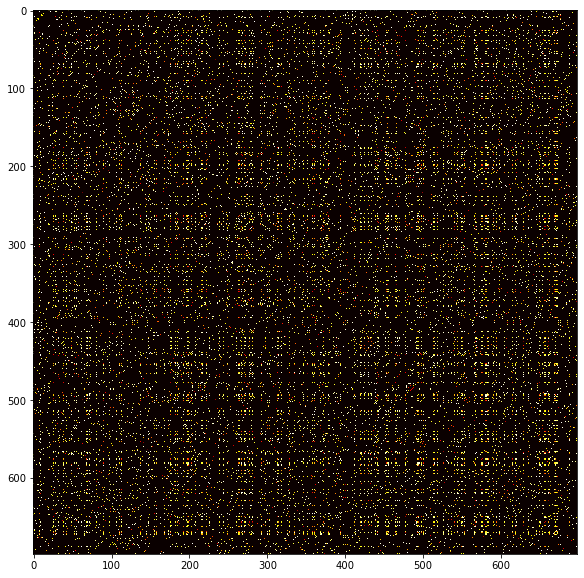

In [19]:
plt.imshow(A_eps_eucl, cmap='hot', interpolation='nearest')

Having tuned my epsilon to = 12, we can see more or less the sparsity of the connections of the datapoints, with interesting patterns showing up, due to the structure of the underlying data. Then, I plot the network with networkX. The first plot is a simple plot of the nodes, to see the overall structure of the network (without the photos cluttering it), and the second is with the photos, as asked in the question prompt.

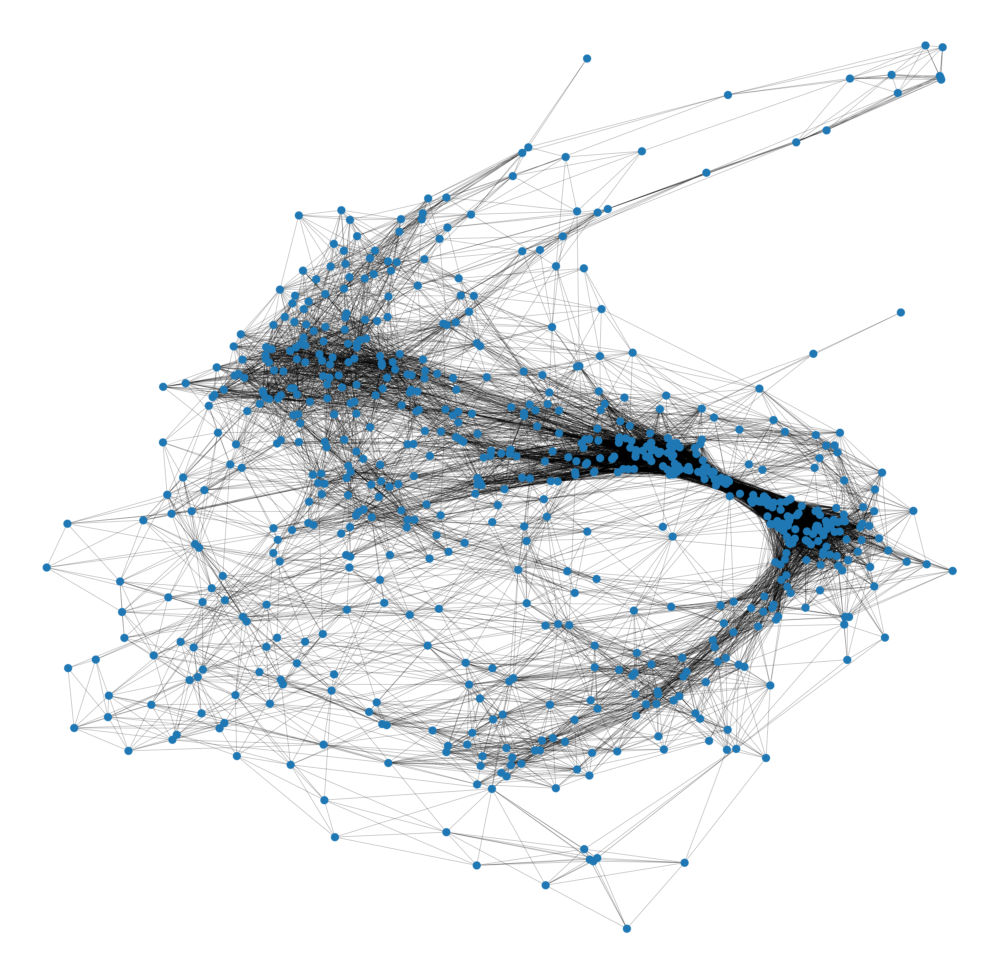

In [20]:
G = nx.Graph(A_eps_eucl)
fig = plt.figure(figsize=(100,100))
ax=plt.subplot()
nx.draw(G, node_size=2000, ax=ax)

The plot of the network shows that a lot of points are very inter-connected, most likely due to the very small shifts in the photo's perspective/angle of the face. We do see this nice movement of connection from the points in the tight cluster, and then we have the edges of the network which are still strongly connected, but are far away from the nodes on the other end. Finally, there is a web of points on the outside of the network that have very few connections, due to their dissimilarity with the other photos. 

Below, I will plot the images in the network.

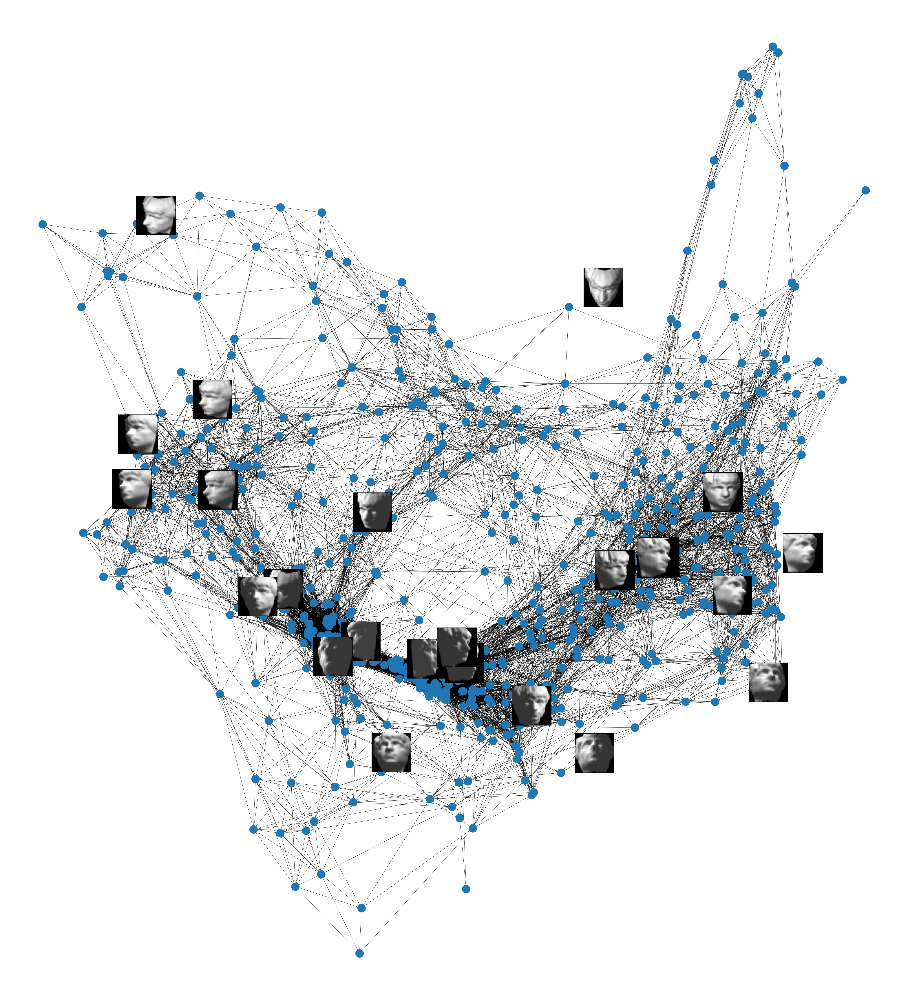

In [21]:
# Plotting images code lines inspired directly by: https://groups.google.com/g/networkx-discuss/c/qhHjh0CGP8A?pli=1
rg = range(0,A_eps_eucl.shape[0],30)
G = nx.from_numpy_matrix(A_eps_eucl)
pos = nx.spring_layout(G)
for i in rg:   
    G.nodes[i]['images'] = ndimage.rotate(hm[i,:].reshape((64,64)),-90)
    G.nodes[i]['images'] = ndimage.rotate(hm[i,:].reshape((64,64)),-90)
    G.nodes[i]['images'] = ndimage.rotate(hm[i,:].reshape((64,64)),-90)
    G.nodes[i]['images'] = ndimage.rotate(hm[i,:].reshape((64,64)),-90)
fig = plt.figure(figsize=(100,100))
ax=plt.subplot(111)
ax.set_aspect('equal')
nx.draw(G, node_size=2000, pos=pos, ax=ax)

trans=ax.transData.transform
trans2=fig.transFigure.inverted().transform

piesize=0.03
p2=piesize/100
for n in rg:
    xx,yy=trans(pos[n])
    xa,ya=trans2((xx,yy)) 
    a = plt.axes([xa-p2,ya-p2, piesize, piesize])
    a.set_aspect('equal')
    a.imshow(G.nodes[n]['images'],cmap='gray')
    a.axis('off')
plt.show()


With the photos, we can clearly see the trends we expect, in the way the points are connected. Photos with similar persepctives of the subject are tightly connected, and there's a progression of facial movement as we move along the network.

## Part b

Now, taking this weighted A, I can implement an ISOMAP algorithm to perform ISOMAP dimensionality reduction, the process of which I explained in a previous paragraph, in the introduction to question 3. Thus, I run my function that I created, ISOMAP_tjl, and get the output of the final 2-eigenvectors created via eigendecomposition of the aforementioned C matrix. This Z matrix will contain the first two eigenvectors, which can then be plotted in a 2D scatterplot. 

Finally, I do plot Z using my function, plot_ISOMAP, which plots the points of Z, and plots a smattering of the original photos as annotations of their datapoint in the scatterplot. 

In [22]:
Z_eucl = ISOMAP_tjl(A_eps_eucl,A_eps_eucl.shape[0], 2)

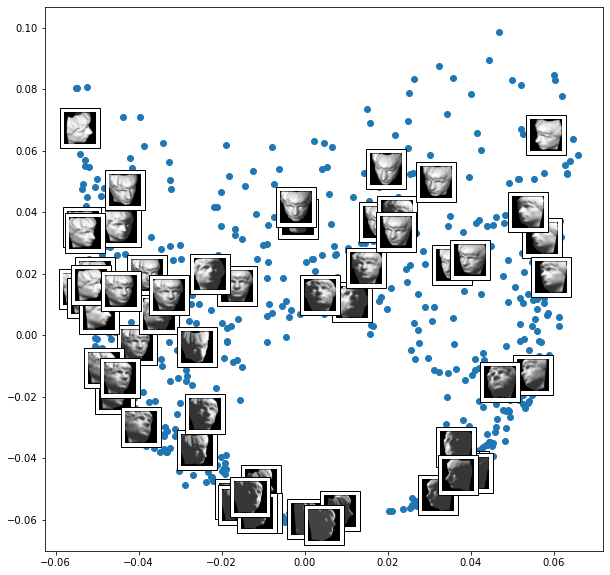

In [23]:
plot_ISOMAP(hm,Z_eucl,img_redux=12)

As can be seen, ISOMAP'ing seems to have worked VERY well! As can clearly be seen, there is a sense of movement of the face in the photos. In the top-left corner, the head is seen from the top, looking at the scalp, with his nose pointed inward. As we move down from the top to the bottom on any of the trajectory of scattered points, we see the point of view of the face move from a top-down view to a down-top view. Also, moving from top to bottom, we see a change from really well-lit photos to really dark, shadowed photos, which usually correlate to the bottom-up POV photos (looking at the chin). Furthermore, as we move from left to right, the faces line of vision moves from looking to the right, to the center, and finally to the left, always looking "inward", but definitely following a steady progression of vision from right to left as we move from left to right on the graph's visual space. Thus, it seems that the natural distances in the data is well preserved using this method, and plotting the data in a 2D space.

To truly be able to compare the performance of this method, however, we will perform the same process using the Manhattan distance to formulate the weighted-A, as a means of comparison, and then use simple PCA, to see if this truly performs better.

## Part c

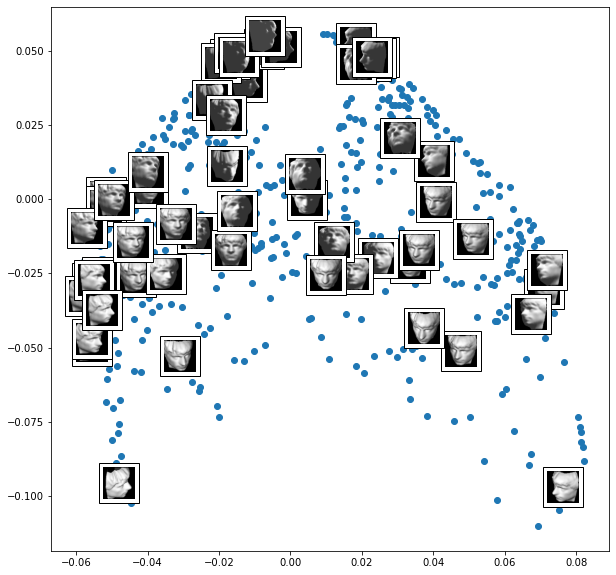

In [24]:
A_eps_manh = construct_adj_eps(hm,epsilon=400,dist_num=1)
Z_manh = ISOMAP_tjl(A_eps_manh,A_eps_manh.shape[0], 2)
plot_ISOMAP(hm,Z_manh,img_redux=12)

For part c, as mentioned above, we use the Manhattan distance function to calculate the distances between the points when constructing the weighted-adjacency matrix, which is then used in a similar fashion to perform ISOMAP'ing. 

As can be seen from the results above, what was really interesting is that, due to the manhattan distance of the points, a very high value of epsilon is needed (400 is my best tuned value for epsilon). In reality, however, this makes perfect sense, due to the extremely high dimensionality of the data, and the fact that the manhattan distance is not a direct distance measure, but sums the distances of all dimensions from one point to another. 

After properly tuning epsilon, there are almost no differences in the final result, in terms of the orientation of the photos in a 2D space. The photos show nearly identical patterns of "movement" of the face, going from top to bottom and left to right, even if the graph itself is flipped. Thus, at least for this example, it didn't seem to matter if we use one distance measure over the other.

## Part d

For part d, I will now be using simple PCA to compare against ISOMAP, and see if there is truly any difference in the result. To do so, I will use my same PCA_TJL function that I created for question 2, but this time, taking the transpose of the matrix of photos, as I am now reducing dimensionality PER PHOTO into two principle components, rather that reducing the dimensionality PER PIXEL, or in other words, condensing the photos into k-principle components, as was done in question 2 (justifying the need to use the transpose in this case, due to the features being reduced, rather than the variation per feature). 

This function similarly gives me a Z-matrix, with 2 eigenvectors. I can then plot this using the same function as before, and analyze the result.

In [25]:
Z_part_d = PCA_TJL(hm.T,2)

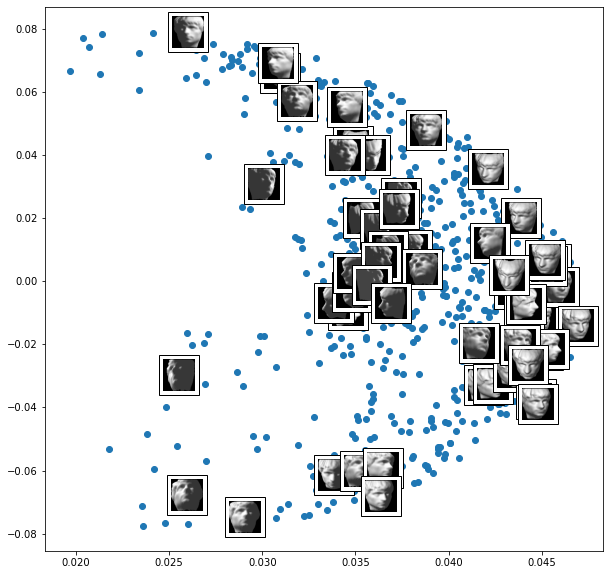

In [26]:
plot_ISOMAP(hm,Z_part_d,img_redux=12)

As can be seen, the layout of these datapoints, or photos, is MUCH more disorganized! Starting from top-left, as we move down and right, the photos at first seem to be having the gaze, or nose, move from center to the left, but then the trend shows the gaze moving down, and then to the right, and then up again. In the big center-cluster of points, there are gazes upward, to the right, to the left, and downward, showing no good trends in terms of the facial movement, which is just as was expected!! 

However, what is very stark, is that when using PCA, it does a good job at grouping photos together with similar shadowing, regardless of the position of the face. As can be seen, all the really dark photos are clumped together in the middle, regardless of the direction of the face, and similarly, all the lightest color photos are clumped on the right side. Thus, PCA did a good job at looking at these more simple qualities, like overall lightness/darkness of the photo, rather than plotting the photos in order of "facial movement," which is very much non-linear, and requires a process like ISOMAP. 

## Epsilon Tuning

As mentioned previously, the code above is already using a tuned epsilon. My process for tuning epsilon was, after writing all my necessary functions, simply using the epsilon that showed the best progression of "facial movement" among the photos in the 2D space. I will show examples specifically of tuning epsilon for the Euclidean distance version, but I also used the same process for the Manhattan Distance version. 

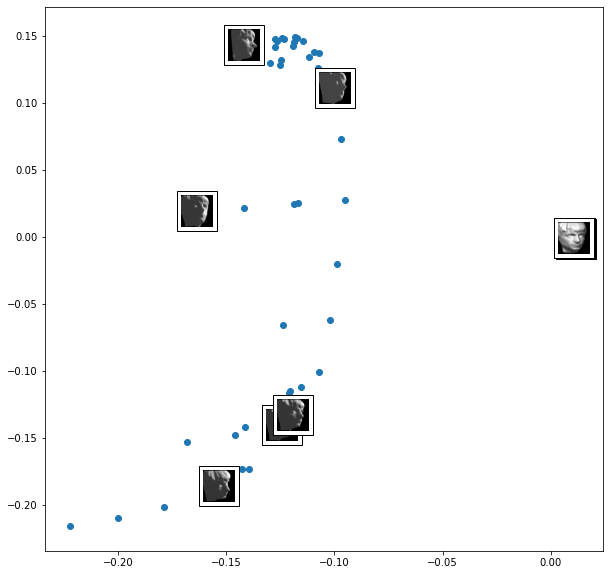

In [27]:
A_temp_tune = construct_adj_eps(hm,epsilon=5,dist_num=2)
Z_temp_tune = ISOMAP_tjl(A_temp_tune,A_temp_tune.shape[0], 2)
plot_ISOMAP(hm,Z_temp_tune,img_redux=12)

As can be seen, when epsilon is too low, the graph is extremely sparse, due to the fact that a low epsilon makes for a weighted-A with a lot of 0 values. 

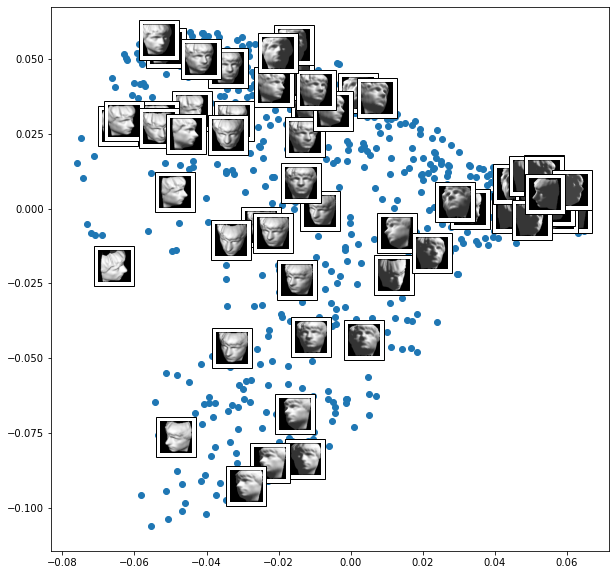

In [28]:
A_temp_tune = construct_adj_eps(hm,epsilon=40,dist_num=2)
Z_temp_tune = ISOMAP_tjl(A_temp_tune,A_temp_tune.shape[0], 2)
plot_ISOMAP(hm,Z_temp_tune,img_redux=12)

An as can be seen for an epsilon that is much too large, such as e=40 in this case, the points are much too highly inter-connected, making the whole spirit of ISOMAP null, not allowing for the seperation of "neighborhoods" of points, and thus we see above a lot more error, with photos in the top left, for example, looking both down and up, and photos in the right clustering looking in all directions. There are much less patterns present. Thus, by repeating this process multiple times, I started with low e-values, and slowly worked my way up, until getting to 12, at which point the accuracy objectively looked the best, in terms of less photos showing erroneous gaze directions based on the patterns shown. Then, I would try higher values, and saw degredation in the accuracy as I kept increasing epsilon, leading me to again pick 12.

## Question 3 Summary

As can be seen, the "movement" in the gaze of these photos is best preserved when using ISOMAP, to reduce the dimensionality of the photos and plot them in a way preserving their natural "distances" per datapoint, rather than PCA. Thus, we can conclude that the data matrix most likely does NOT have linear patterns, which we could assume given the 360-degree movements of the gaze of the face, which follow different patterns when moving both left to right, up to down, and across the diagonals. And it makes sense why ISOMAP would work better in this case, as gazes that are closer to each other in distance (in other words, slight movements of the gaze up or down, which represents slight movements in the pixel shading for the nose, eyes, hair, etc), should be much closer to each other than gazes that are completely different. And by traveling across the data cloud in the fashion that is iconic of ISOMAP, we do see those steady movements in the gaze of the photo (or in a data-sense, in the shift of the pixel-shade values as the features "move" from photo to photo). 

# Question 4 [Bonus: 5 points]

This bonus questions asks us to use PCA to analyze trends in the food consumption of 16 differnt countries (based on 20 different food items). 

As we are asked to write our own code, I simply re-utilize my PCA function I wrote for question 2, which can be universally used for both part a and b, by simply using the transpose vs the original data matrix.

As mentioned, in part A, we will be reducing the dimensionality of food-item-consumption PER COUNTRY, leaving us with a 2D representation of the consumption PER COUNTRY (and thus each data point will represent a country). Then, in part b, we will switch it up, and reduce the dimensionality of the countries per food item, thus leaving us with a 2D representation in which each food item is plotted.  

In the following code, I load the data using pandas.

In [29]:
food = pd.read_csv(r"data/food-consumption.csv")

## Part a

Now, with the data loaded, I perform PCA with my pre-existing PCA function, PCA_TJL. 

As asked in the question, to make it so that we are reducing the dimensionality of consumption per country, I have to pass in to my function the transpose of the food matrix, which originally comes in as being the rows representing the countries, and the columns representing the food items (a 16x20 matrix). Thus, as needed to utilize my function, I pass in the transpose, a 20x16 matrix, with the countries now as the columns. In my function, as can be seen, I take a transpose, which was originally constructed for the specifics of problem 2, thus why I pass in these matrices "backwards", due to the specifics of the function.

In the code below, I turn the food matrix into an array, not taking the country names column, but only the food value items. Then, I pass the transpose of this into my PCA_TJL function, and get the top-2 eigenvectors, which I can then plot. To make the final graphing easier, I merge the country names in with the column eigenvectors into a dataframe, and then use a for loop to plot each annotation with its data point in the 2D graph.

In [30]:
food_groups = pd.Series(food.columns[food.columns != 'Country'])

In [31]:
food_m = np.array(food.iloc[:,1:])
food_eigvecs = PCA_TJL(food_m.T,2)
eig_df = pd.concat([pd.DataFrame(food_eigvecs),food['Country']],axis=1)

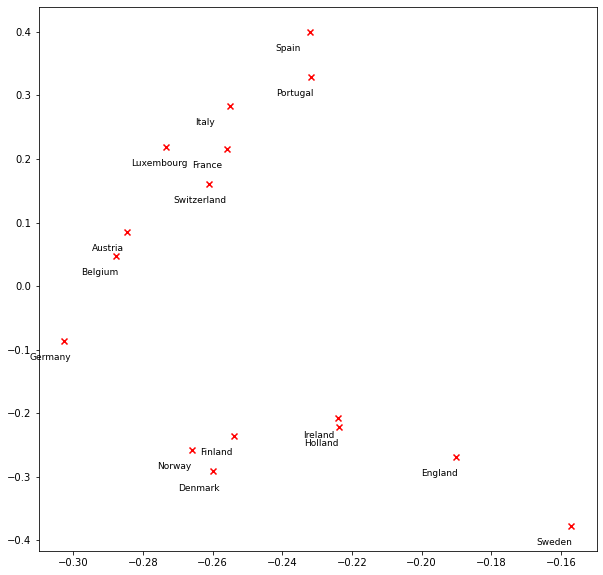

In [32]:
for word in eig_df['Country']:
    x, y = eig_df[eig_df['Country']==word][0],eig_df[eig_df['Country']==word][1]
    plt.scatter(x, y, marker='x', color='red')
    plt.text(x-0.01, y-0.03, word, fontsize=9)
plt.show()
# This code gained from Stack Overflow:https://stackoverflow.com/questions/14432557/matplotlib-scatter-plot-with-different-text-at-each-data-point

As can be seen, there are DEFINITE patterns in the plot! The entire top-left corn is taken up by western-European countries, where south-western countries are aggregated on the top middle (Spain, Portugal, Italy, France), whereas more Western-Europe countries that are closer together are aggregated in a somewhat wide space on the left side of the graph (Germany, Belgium, Austria, Switzerland). Then, completely separate from this swath of countries on the top/left corner, are the countries on the bottom of the graph, made up entirely of countries in strictly northern Europe. What is very interesting is that Sweden is completely isolated from its neighboring countries, Finland, Norway, and Denmark, and is closest to England, even if still not very close. It would be interesting to see why Sweden is so unique. Futhermore, England and Ireland are somewhat separated, with Ireland much closer to Holland in terms of diet. yet, the pattern for Northern Europe is still quite distinct from that of Western Europe, and certain groupings, like Finland/Norway/Denmark show strong trends, which is completely expected.

## Part "c"

Then, in Part b, we flip the matrix, and reduce the dimensionality of each country per food item, looking for trends in food item consumption. The same exact process is performed, except that now the matrix is passed in without a transpose (again, see notes on the shape of the matrix being passed in due to my specific function workings).

In [33]:
food_m2 = np.array(food.iloc[:,1:])
food_eigvecs2 = PCA_TJL(food_m,2)
eig_df2 = pd.concat([pd.DataFrame(food_eigvecs).rename({0:'PCA1',1:'PCA2'},axis=1),food_groups],axis=1).rename({0:'food groups'},axis=1)

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


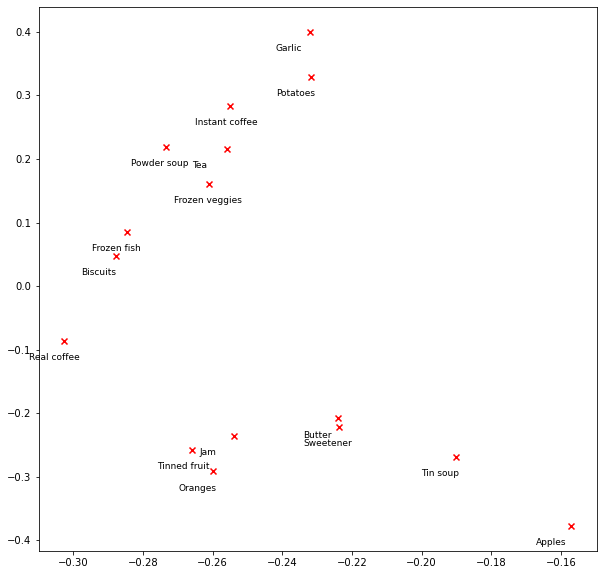

In [34]:
for word in eig_df2['food groups']:
    x, y = eig_df2[eig_df2['food groups']==word]['PCA1'],eig_df2[eig_df2['food groups']==word]['PCA2']
    plt.scatter(x, y, marker='x', color='red')
    plt.text(x-.01, y-0.03, word, fontsize=9)
plt.show()

There are definitely some interesting patterns, which, to me, do not seem as stark as the per-country correlations and patterns/trends. 

In this case, any trends, or proximity of food items, would represent these food items being consumed in more or less similar quantities or proportions to each other across different countries. 

Some of the trends are obvious, and make sense, like the proximity of Jam, Tinned Fruit, and Oranges, which we might expect to be consumed in similar patterns, as they are all sweet fruit products. 

On the bottom hemisphere in general, we see mostly sweet products, with the slightly isolated point of Tin Soup, which seems unrelated. Butter also shows up in this region, which could be due to being a topping used similarly to fruit spreads, or due to baking. Apples are fairly isolated, but still share the same region as the other fruit products, which might be due to apples being sweet, but also acidic, thus not being so similar to the consumption of the sweeter products.

Then, on the left/top region, we see mostly savory foods and beverages. I found it very interesting that instant coffee and real coffee are so far from each other, meaning they have pretty distinct patterns of consumption from each other from one country to the next. Still, as mentioned, the graph overall seems to show that PCA did well in making distinctions between sweeter and more savory food groups. 